In [1]:
import os
os.environ['THEANO_FLAGS'] = 'floatX=float32,device=cuda'


In [2]:
IMG_C,IMG_H,IMG_W = 3, 48,48

In [3]:
import glob
png_list = glob.glob("animeface-character-dataset/thumb/*/*.png")

In [4]:
from PIL import Image
import numpy as np
from IPython.display import display
def showX(X, rows=1):
    assert X.shape[0]%rows == 0
    int_X = ( (X+1)/2*255).clip(0,255).astype('uint8')
    int_X = np.moveaxis(int_X, 1, 3)
    int_X = int_X.reshape(rows, -1, IMG_H, IMG_W,3)
    int_X = int_X.swapaxes(1,2).reshape(rows*IMG_H,-1, 3)
    img = Image.fromarray(int_X)
    display(img)
def saveX(X, fn, rows=1):
    assert X.shape[0]%rows == 0
    int_X = ( (X+1)/2*255).clip(0,255).astype('uint8')
    int_X = np.moveaxis(int_X, 1, 3)
    int_X = int_X.reshape(rows, -1, IMG_H, IMG_W,3)
    int_X = int_X.swapaxes(1,2).reshape(rows*IMG_H,-1, 3)
    img = Image.fromarray(int_X)
    img.save(fn)

In [5]:
train_X = np.ones((len(png_list), IMG_C, IMG_H,IMG_W), dtype='float32')
for i, png in enumerate(png_list):
    img = Image.open(png)
    img.thumbnail((IMG_H,IMG_W))
    img = np.array(img)/255*2-1
    h, w = img.shape[:2]
    y, x = (IMG_H-h)//2, (IMG_W-w)//2
    img = img.swapaxes(1,2).swapaxes(0,1)
    #print(img.shape, y,x,h,w)
    train_X[i, :, y:y+h, x:x+w] = img[:3]

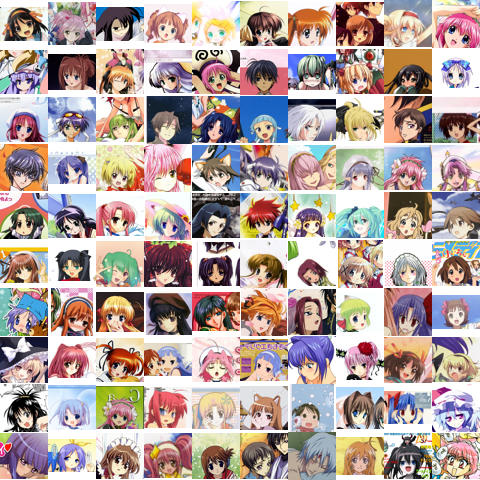

In [6]:
train_X = np.concatenate([train_X[:,:,:,::-1], train_X])
np.random.shuffle(train_X)
showX(train_X[:100], 10)

In [7]:
import numpy as np
import theano
import theano.tensor as T
import lasagne
from lasagne.layers import DenseLayer, DropoutLayer, ReshapeLayer, InputLayer, FlattenLayer, Upscale2DLayer, LocalResponseNormalization2DLayer
floatX = theano.config.floatX
from lasagne.layers import MaxPool2DLayer, Conv2DLayer, TransposedConv2DLayer
from lasagne.layers import batch_norm

Using cuDNN version 5105 on context None
Mapped name None to device cuda: GeForce GTX 980 (0000:01:00.0)


In [8]:
conv_init = lasagne.init.Normal(0.05, 0)
gamma_init = lasagne.init.Normal(0.02, 1)

In [9]:
def DCGAN_D(isize, nz, nc, ndf, n_extra_layers=0):
    _ = InputLayer(shape=(None, nc, isize, isize))
    _ = Conv2DLayer(_, num_filters=ndf, filter_size=4, stride=2, pad=1, b=None, W=conv_init, flip_filters=False,
               name = 'initial.conv.{0}-{1}'.format(nc, ndf), 
                nonlinearity=lasagne.nonlinearities.LeakyRectify(0.2))
    csize, cndf = isize // 2, ndf
    while csize > 5:
        in_feat = cndf
        out_feat = cndf*2
        _ = Conv2DLayer(_, num_filters=out_feat, filter_size=4, stride=2, pad=1, b=None, W=conv_init, 
                                   flip_filters=False,
               name = 'pyramid.{0}-{1}.conv'.format(in_feat, out_feat), 
                nonlinearity=lasagne.nonlinearities.LeakyRectify(0.2))
        if 0: # change this line to turn on batch_norm
            _ = batch_norm(_, epsilon=1e-5)
        csize, cndf = csize//2, cndf*2
        
    _ = Conv2DLayer(_, num_filters=1, filter_size=csize, stride=1, pad=0, b=None, W=conv_init, 
                    flip_filters=False,
               name = 'final.{0}-{1}.conv'.format(cndf, 1), 
                nonlinearity=None)
    _ = FlattenLayer(_)
    return _


In [10]:
def DCGAN_G(isize, nz, nc, ngf, n_extra_layers=0):
    cngf= ngf//2
    tisize = isize
    while tisize > 5:
        cngf = cngf * 2
        tisize = tisize // 2
    _ = InputLayer(shape=(None, nz))
    _ = ReshapeLayer(_, (-1, nz, 1,1))
    _ = TransposedConv2DLayer(_, num_filters=cngf, filter_size=tisize, stride=1, crop=0, b=None, 
                              W=conv_init,
               name =  'initial.{0}-{1}.convt'.format(nz, cngf))
    _ = batch_norm(_, epsilon=1e-5)
    csize, cndf = tisize, cngf
    
    while csize < isize//2:
        in_feat = cngf
        out_feat = cngf//2
        _ = TransposedConv2DLayer(_, num_filters=out_feat, filter_size=4, stride=2, crop=1, b=None, W=conv_init,
               name = 'pyramid.{0}-{1}.convt'.format(in_feat, out_feat))
        _ = batch_norm(_, epsilon=1e-5)
        csize, cngf = csize*2, cngf//2
    _ = TransposedConv2DLayer(_, num_filters=nc, filter_size=4, stride=2, crop=1, b=None, W=conv_init,
               name = 'final.{0}-{1}.convt'.format(cngf, nc), nonlinearity=lasagne.nonlinearities.tanh)       
    return _


In [11]:
nc = IMG_C
nz = 40
ngf = 128
ndf = 128
n_extra_layers = 0
Diters = 5
assert IMG_H == IMG_W
imageSize = IMG_H
batchSize = 64
lrD = 5e-4
lrG = 5e-4


In [12]:
netD = DCGAN_D(imageSize, nz, nc, ndf, n_extra_layers)
for l in lasagne.layers.get_all_layers(netD):
    print(l.name,  l.output_shape)

None (None, 3, 48, 48)
initial.conv.3-128 (None, 128, 24, 24)
pyramid.128-256.conv (None, 256, 12, 12)
pyramid.256-512.conv (None, 512, 6, 6)
pyramid.512-1024.conv (None, 1024, 3, 3)
final.1024-1.conv (None, 1, 1, 1)
None (None, 1)


In [13]:
netG = DCGAN_G(imageSize, nz, nc, ngf, n_extra_layers)
for l in lasagne.layers.get_all_layers(netG):
    print(l.name,  l.output_shape)

None (None, 40)
None (None, 40, 1, 1)
initial.40-1024.convt (None, 1024, 3, 3)
initial.40-1024.convt_bn (None, 1024, 3, 3)
initial.40-1024.convt_bn_nonlin (None, 1024, 3, 3)
pyramid.1024-512.convt (None, 512, 6, 6)
pyramid.1024-512.convt_bn (None, 512, 6, 6)
pyramid.1024-512.convt_bn_nonlin (None, 512, 6, 6)
pyramid.512-256.convt (None, 256, 12, 12)
pyramid.512-256.convt_bn (None, 256, 12, 12)
pyramid.512-256.convt_bn_nonlin (None, 256, 12, 12)
pyramid.256-128.convt (None, 128, 24, 24)
pyramid.256-128.convt_bn (None, 128, 24, 24)
pyramid.256-128.convt_bn_nonlin (None, 128, 24, 24)
final.128-3.convt (None, 3, 48, 48)


In [14]:
input_var_D = lasagne.layers.get_all_layers(netD)[0].input_var
input_var_G = lasagne.layers.get_all_layers(netG)[0].input_var
ϵ = T.TensorType(dtype=floatX,broadcastable=(False, True, True, True))()


In [15]:
no_bn_avg = dict(       batch_norm_update_averages=False,
                       batch_norm_use_averages=False)
output_D = lasagne.layers.get_output(netD, **no_bn_avg)
output_G = lasagne.layers.get_output(netG, **no_bn_avg)

output_D_fake = lasagne.layers.get_output(netD, inputs=output_G, **no_bn_avg)

/usr/local/lib/python3.5/dist-packages/lasagne/layers/helper.py:209: UserWarning: get_output() was called with unused kwargs:
	batch_norm_use_averages
	batch_norm_update_averages
  % "\n\t".join(suggestions))


In [16]:
mixed_X = (ϵ * output_G) + (1-ϵ) * input_var_D

In [17]:
output_D_mixed = lasagne.layers.get_output(netD, inputs=mixed_X, **no_bn_avg)

/usr/local/lib/python3.5/dist-packages/lasagne/layers/helper.py:209: UserWarning: get_output() was called with unused kwargs:
	batch_norm_use_averages
	batch_norm_update_averages
  % "\n\t".join(suggestions))


In [18]:
grad_mixed = T.grad(T.sum(output_D_mixed), mixed_X)
norm_grad_mixed = T.sqrt(T.sum(T.square(grad_mixed),axis=[1,2,3]))
grad_penalty = T.mean(T.square(norm_grad_mixed - 64))

In [19]:
loss_D_real = output_D.mean()
loss_D_fake = output_D_fake.mean()
loss_D = loss_D_fake - loss_D_real +  10*grad_penalty/(64**2)
loss_G = -loss_D_fake


params_netD = lasagne.layers.get_all_params(netD, trainable=True) 
params_netG = lasagne.layers.get_all_params(netG, trainable=True)
#optimize_G = lasagne.updates.rmsprop(loss_G, params_netG, learning_rate=lrG)
optimize_G = lasagne.updates.adam(loss_G, params_netG, learning_rate=lrG, beta1=0)
#optimize_D = lasagne.updates.rmsprop(loss_D, params_netD, learning_rate=lrD)
optimize_D = lasagne.updates.adam(loss_D, params_netD, learning_rate=lrD, beta1=0)
train_G_fn =  theano.function([input_var_G], [loss_G], updates=optimize_G)
train_D_fn = theano.function([input_var_D, input_var_G, ϵ], [loss_D, loss_D_real, loss_D_fake], 
                                         updates=optimize_D)
generator_fn = theano.function([input_var_G], output_G)

In [20]:
fixed_noise = np.random.normal(size=(batchSize, nz)).astype('float32')

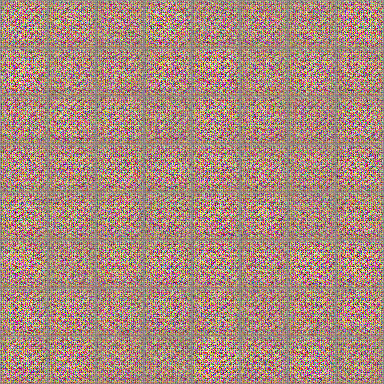

[0/500][100/452][0] Loss_D: -245243.187500 Loss_G: 117106.390625 Loss_D_real: 322976.093750 Loss_D_fake -162974.734375 45.70376372337341


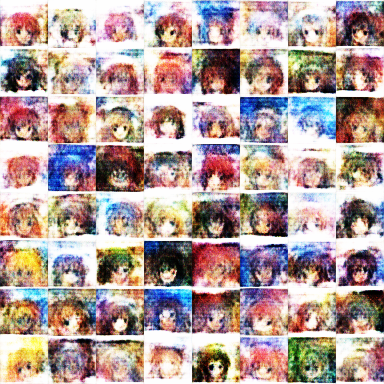

[10/500][200/452][500] Loss_D: -12934.859375 Loss_G: 14836.976562 Loss_D_real: 19087.634766 Loss_D_fake -3595.574707 1997.9389142990112


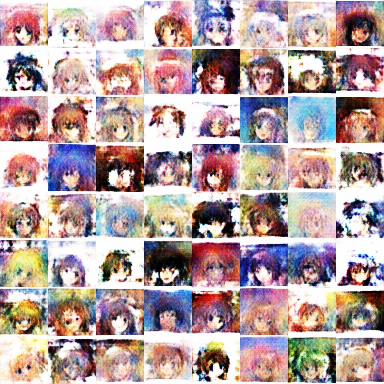

[15/500][452/452][1000] Loss_D: -5002.766602 Loss_G: -380.117035 Loss_D_real: 15703.548828 Loss_D_fake 4560.226562 3089.4842298030853


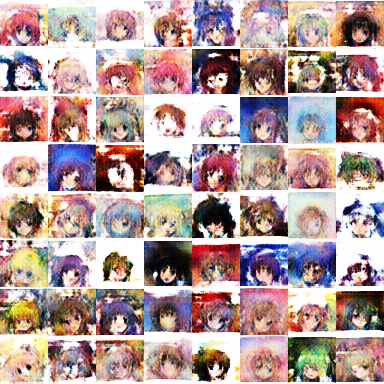

[21/500][320/452][1500] Loss_D: -8815.515625 Loss_G: 3644.093750 Loss_D_real: 14880.287109 Loss_D_fake -587.839722 4208.830850362778


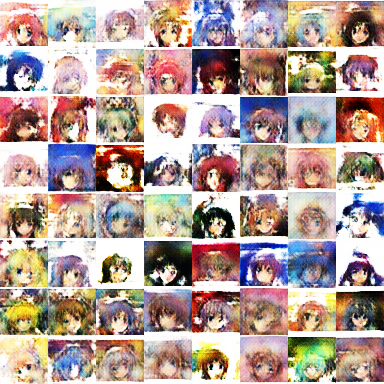

[27/500][185/452][2000] Loss_D: -9680.283203 Loss_G: -2509.697754 Loss_D_real: 18148.291016 Loss_D_fake 1743.408936 5327.777406692505


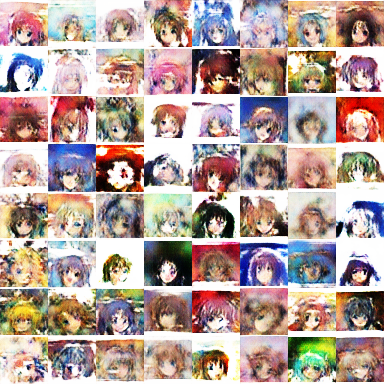

[32/500][452/452][2500] Loss_D: -4597.320312 Loss_G: 1913.145752 Loss_D_real: 13908.275391 Loss_D_fake 4533.466797 6426.185163021088


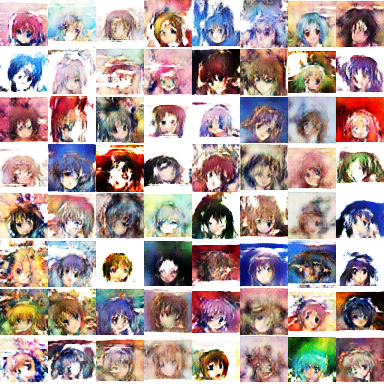

[38/500][320/452][3000] Loss_D: -5481.736328 Loss_G: 1870.052246 Loss_D_real: 14098.466797 Loss_D_fake 3831.748047 7546.547647953033


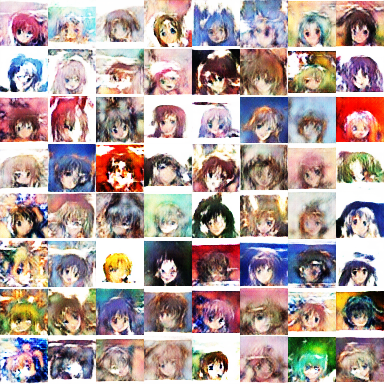

[44/500][185/452][3500] Loss_D: -7590.761719 Loss_G: -616.763062 Loss_D_real: 8327.728516 Loss_D_fake -4401.639648 8665.350762367249


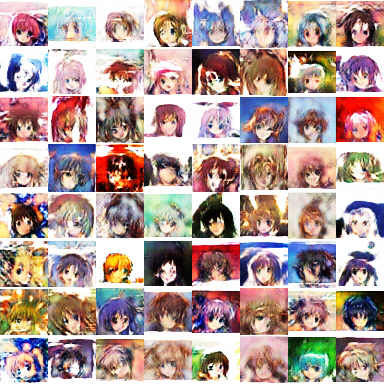

[49/500][452/452][4000] Loss_D: -4501.652344 Loss_G: 11134.731445 Loss_D_real: -4571.177734 Loss_D_fake -12741.380859 9763.723414897919


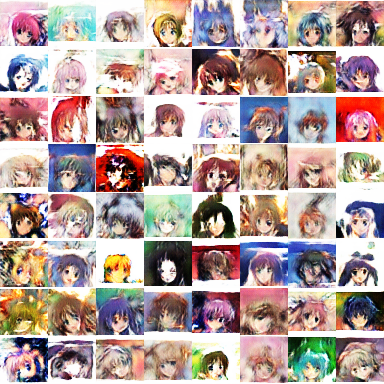

[55/500][320/452][4500] Loss_D: -3347.594727 Loss_G: 2820.164062 Loss_D_real: 2180.629150 Loss_D_fake -4598.494141 10883.555051326752


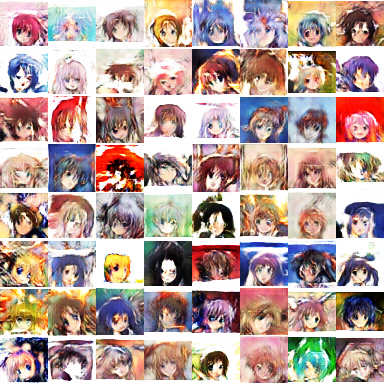

[61/500][185/452][5000] Loss_D: -5153.214844 Loss_G: 2947.920898 Loss_D_real: 1881.725708 Loss_D_fake -7231.693848 12002.64608335495


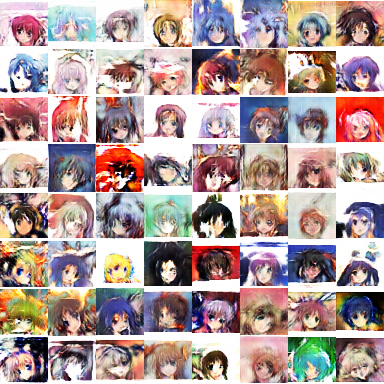

[66/500][452/452][5500] Loss_D: -4201.207031 Loss_G: -1969.595703 Loss_D_real: 9890.262695 Loss_D_fake 2258.061523 13100.837552070618


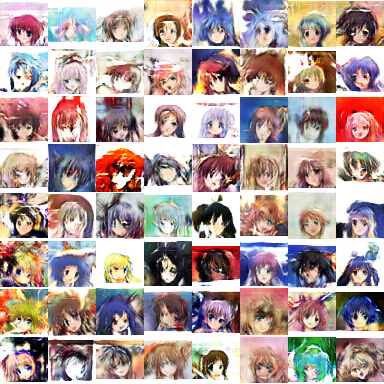

[72/500][320/452][6000] Loss_D: -3851.917969 Loss_G: 3238.495850 Loss_D_real: 3437.690186 Loss_D_fake -3882.507080 14221.454089403152


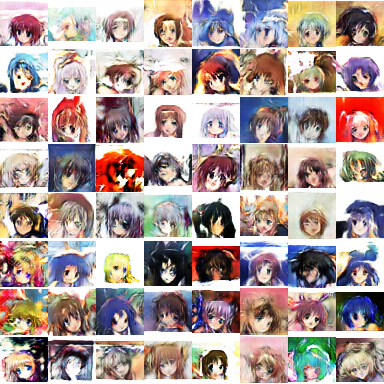

[78/500][185/452][6500] Loss_D: -1190.831055 Loss_G: 758.668640 Loss_D_real: 7800.276855 Loss_D_fake 1583.125244 15340.793175458908


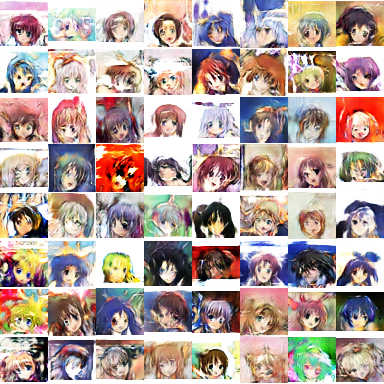

[83/500][452/452][7000] Loss_D: -4170.560547 Loss_G: -4371.068359 Loss_D_real: 9163.954102 Loss_D_fake 2341.219971 16439.61137533188


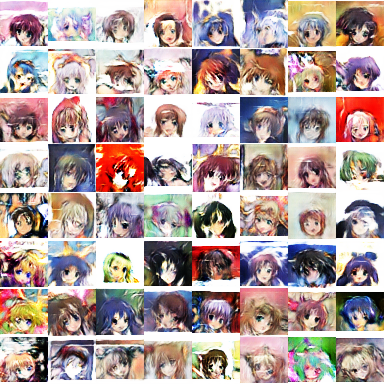

[89/500][320/452][7500] Loss_D: -3310.514648 Loss_G: 2160.091064 Loss_D_real: 7172.517090 Loss_D_fake 787.343201 17560.575003623962


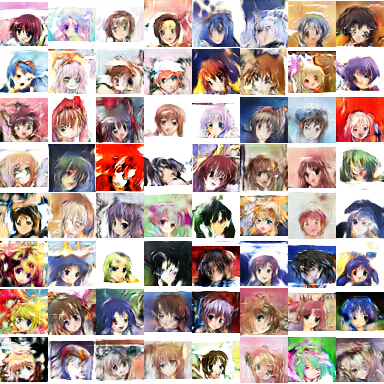

[95/500][185/452][8000] Loss_D: -2531.533691 Loss_G: 1886.444458 Loss_D_real: 5742.037598 Loss_D_fake 461.865234 18680.260732650757


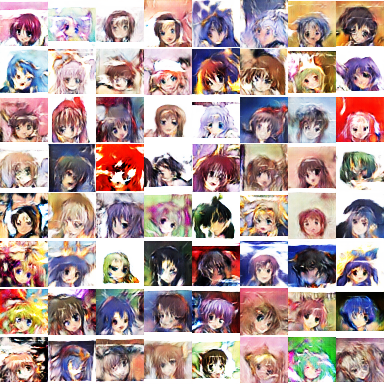

[100/500][452/452][8500] Loss_D: -3018.911865 Loss_G: 4330.776367 Loss_D_real: -104.123169 Loss_D_fake -5765.215332 19779.353868961334


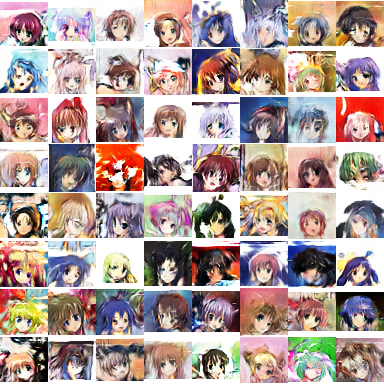

[106/500][320/452][9000] Loss_D: -3546.189941 Loss_G: -1704.893677 Loss_D_real: 5112.991699 Loss_D_fake -1128.294189 20900.150607824326


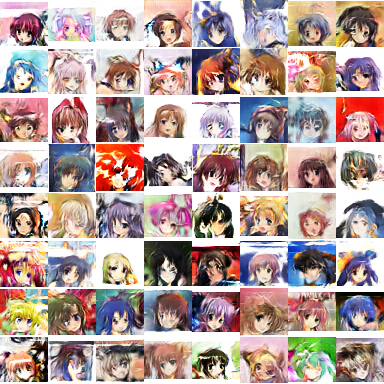

[112/500][185/452][9500] Loss_D: -2708.720947 Loss_G: -1515.562500 Loss_D_real: 6845.985840 Loss_D_fake 1356.331055 22020.018639326096


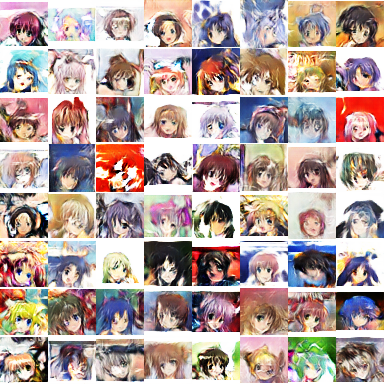

[117/500][452/452][10000] Loss_D: -3217.974854 Loss_G: -1827.484741 Loss_D_real: 7733.417480 Loss_D_fake 1954.568481 23119.02541232109


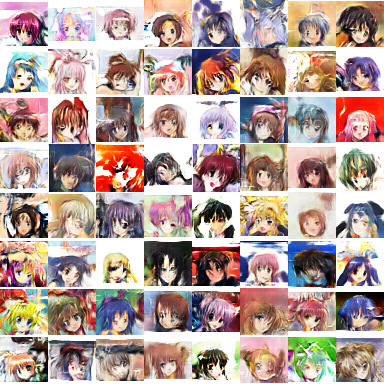

[123/500][320/452][10500] Loss_D: -2365.313477 Loss_G: 3098.460938 Loss_D_real: 3648.103271 Loss_D_fake -1285.819336 24239.943245887756


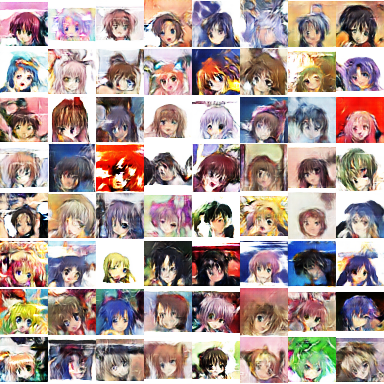

[129/500][185/452][11000] Loss_D: -3949.494629 Loss_G: -6665.512695 Loss_D_real: 4321.100098 Loss_D_fake -2976.081055 25359.640195131302


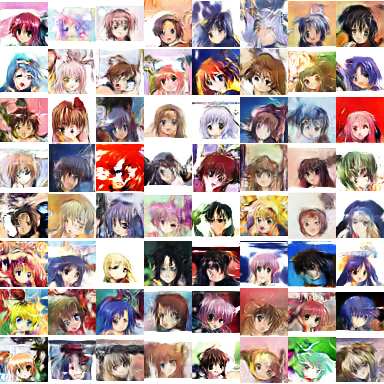

[134/500][452/452][11500] Loss_D: -1847.441162 Loss_G: 7271.977539 Loss_D_real: -4744.181641 Loss_D_fake -9312.707031 26458.76648259163


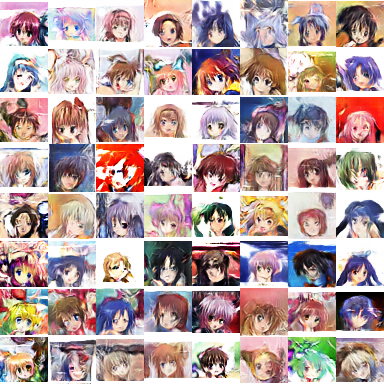

[140/500][320/452][12000] Loss_D: -2787.013672 Loss_G: 605.609619 Loss_D_real: 6907.406738 Loss_D_fake 1538.082397 27579.778072595596


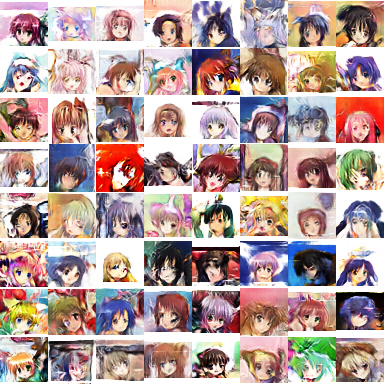

[146/500][185/452][12500] Loss_D: -2975.248047 Loss_G: 6042.066406 Loss_D_real: 637.848999 Loss_D_fake -5008.423828 28699.436020851135


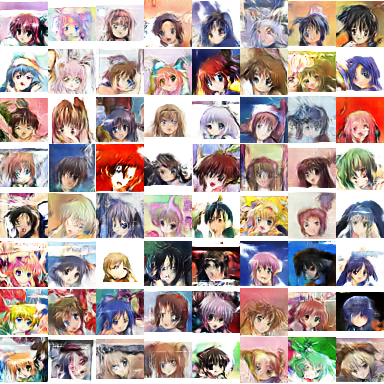

[151/500][452/452][13000] Loss_D: -2634.060059 Loss_G: 824.997803 Loss_D_real: 4250.412109 Loss_D_fake -1012.076294 29798.681583166122


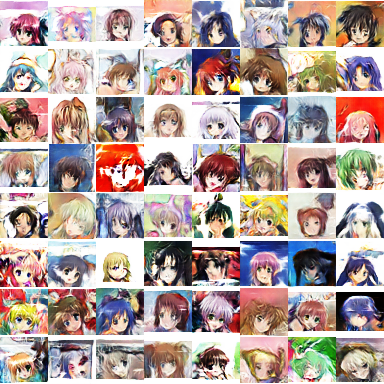

[157/500][320/452][13500] Loss_D: -2229.435547 Loss_G: 11884.431641 Loss_D_real: -1551.103760 Loss_D_fake -6200.627930 30919.660170555115


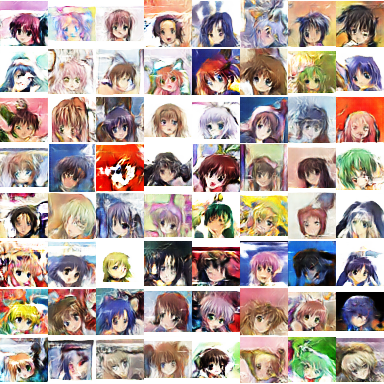

[163/500][185/452][14000] Loss_D: -5140.296875 Loss_G: -11907.314453 Loss_D_real: 14249.877930 Loss_D_fake 5934.410156 32039.5001475811


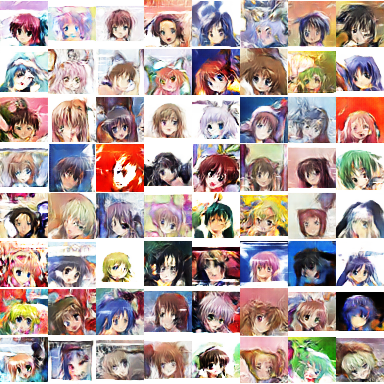

[168/500][452/452][14500] Loss_D: -3362.266602 Loss_G: -5361.381836 Loss_D_real: 8776.921875 Loss_D_fake 3032.034424 33138.50263214111


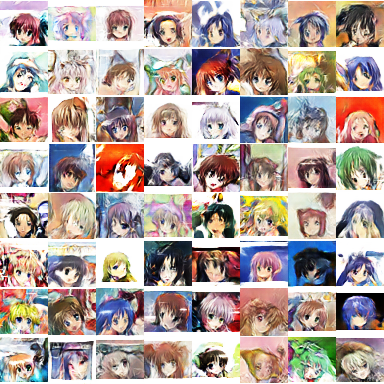

[174/500][320/452][15000] Loss_D: -3435.266113 Loss_G: 5517.897949 Loss_D_real: 6968.880859 Loss_D_fake 849.371216 34280.86167502403


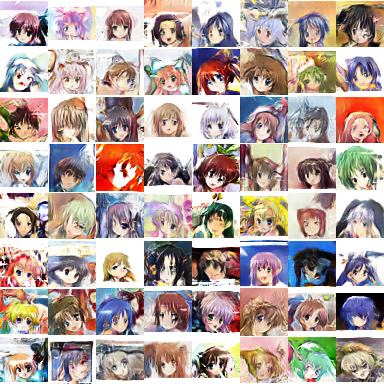

[180/500][185/452][15500] Loss_D: -3113.476807 Loss_G: -7629.055176 Loss_D_real: 10279.577148 Loss_D_fake 4317.347656 35400.50127911568


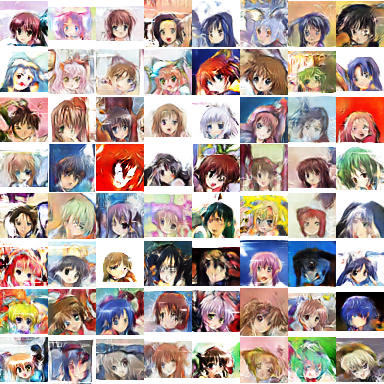

[185/500][452/452][16000] Loss_D: -3116.348389 Loss_G: -3328.674072 Loss_D_real: 10151.365234 Loss_D_fake 4596.999512 36499.28914642334


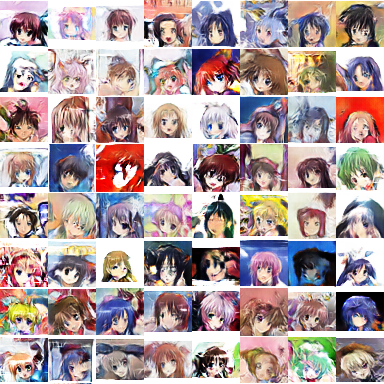

[191/500][320/452][16500] Loss_D: -3586.293701 Loss_G: 2824.790039 Loss_D_real: 4005.225342 Loss_D_fake -2410.917480 37620.294828891754


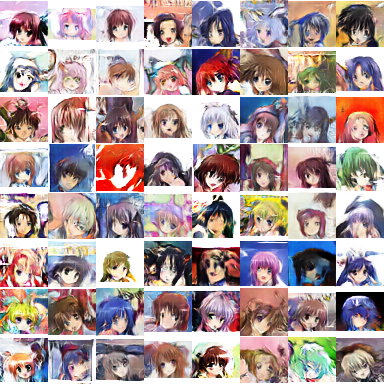

[197/500][185/452][17000] Loss_D: -3624.449951 Loss_G: -9007.169922 Loss_D_real: 10032.381836 Loss_D_fake 3177.925537 38739.86052322388


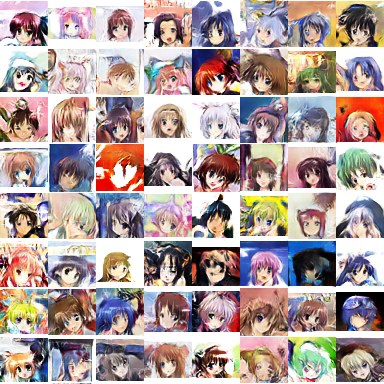

[202/500][452/452][17500] Loss_D: -2634.235596 Loss_G: 6443.486816 Loss_D_real: -5337.988281 Loss_D_fake -10592.316406 39838.76511693001


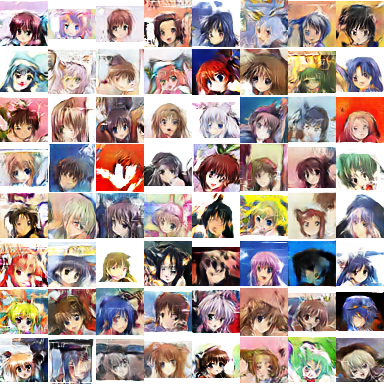

[208/500][320/452][18000] Loss_D: -3935.557617 Loss_G: 2548.676758 Loss_D_real: 5628.624023 Loss_D_fake -1252.105225 40959.49817752838


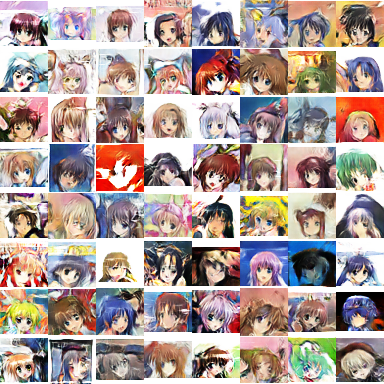

[214/500][185/452][18500] Loss_D: -4172.382812 Loss_G: -4600.743652 Loss_D_real: 18800.466797 Loss_D_fake 11380.544922 42078.93663239479


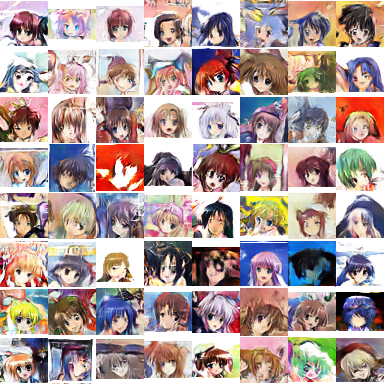

[219/500][452/452][19000] Loss_D: -2429.148926 Loss_G: -7159.506348 Loss_D_real: 6427.939941 Loss_D_fake 1223.220459 43177.82174324989


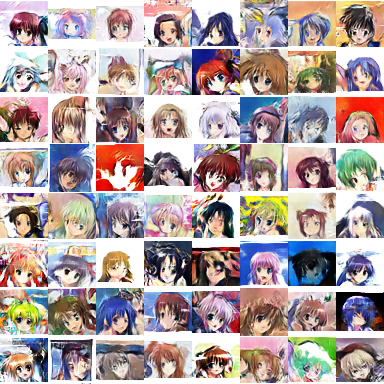

[225/500][320/452][19500] Loss_D: -2871.666260 Loss_G: 1545.065918 Loss_D_real: 6576.820312 Loss_D_fake 875.089233 44298.47998571396


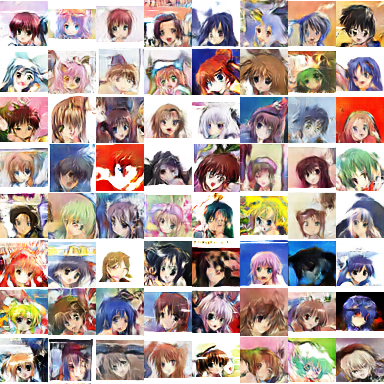

[231/500][185/452][20000] Loss_D: -2123.546631 Loss_G: -355.808685 Loss_D_real: 9849.009766 Loss_D_fake 4811.428711 45425.05293631554


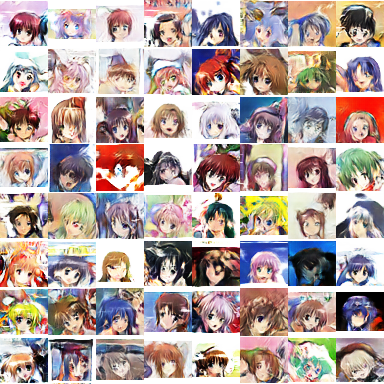

[236/500][452/452][20500] Loss_D: -3008.728516 Loss_G: 3954.013428 Loss_D_real: 1104.221924 Loss_D_fake -5033.947754 46523.82965350151


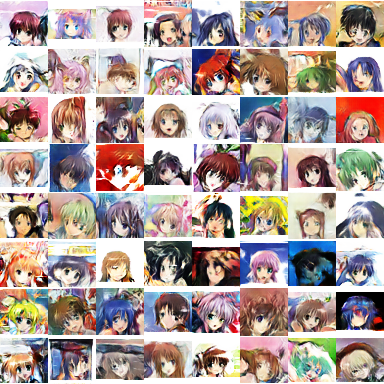

[242/500][320/452][21000] Loss_D: -3436.047852 Loss_G: -3214.988770 Loss_D_real: 6063.037109 Loss_D_fake -475.168396 47644.48773384094


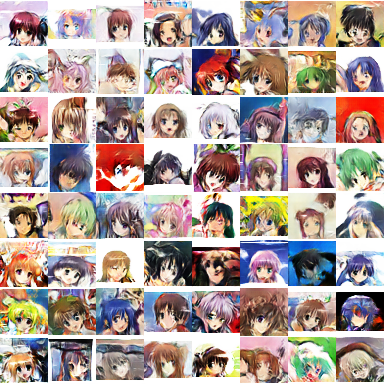

[248/500][185/452][21500] Loss_D: -3958.672607 Loss_G: 259.177643 Loss_D_real: 8538.324219 Loss_D_fake 1596.299927 48763.96242594719


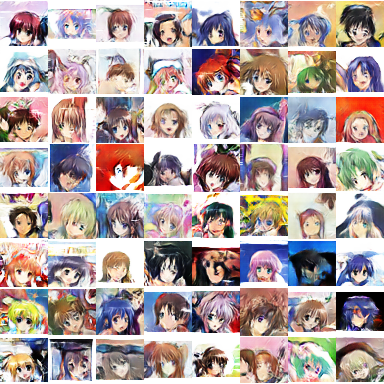

[253/500][452/452][22000] Loss_D: -3636.645264 Loss_G: 1527.869141 Loss_D_real: 6550.468750 Loss_D_fake -550.327942 49862.71252989769


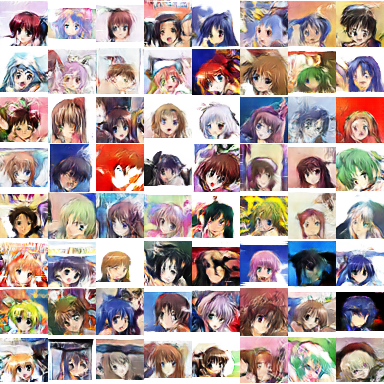

[259/500][320/452][22500] Loss_D: -1523.848633 Loss_G: 977.575378 Loss_D_real: 9727.083008 Loss_D_fake 4895.985352 50983.29695343971


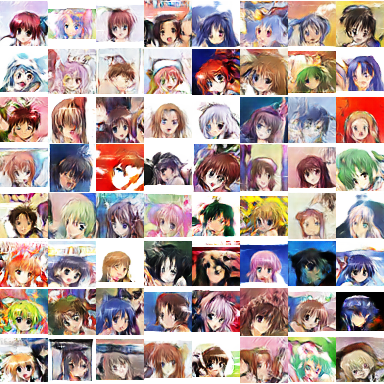

[265/500][185/452][23000] Loss_D: -4107.312500 Loss_G: 8880.876953 Loss_D_real: 1908.816162 Loss_D_fake -5501.224121 52102.926538705826


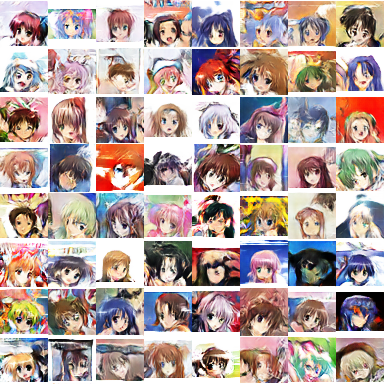

[270/500][452/452][23500] Loss_D: -3134.930664 Loss_G: 447.154022 Loss_D_real: 6484.380859 Loss_D_fake -18.459269 53206.77520275116


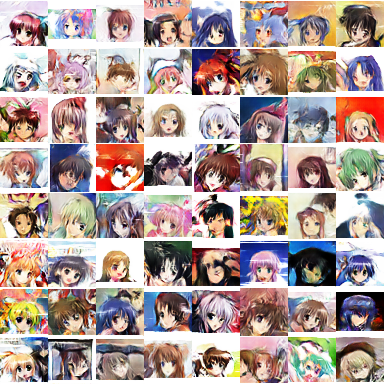

[276/500][320/452][24000] Loss_D: -4560.052734 Loss_G: 2615.388672 Loss_D_real: 8842.170898 Loss_D_fake 648.392761 54345.16801285744


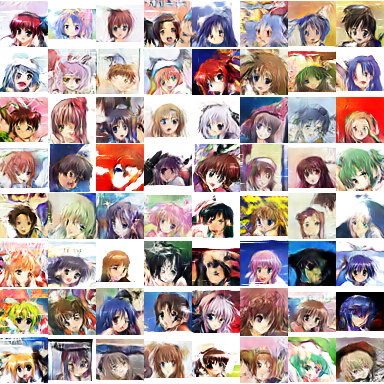

[282/500][185/452][24500] Loss_D: -3631.966553 Loss_G: 6801.974609 Loss_D_real: 533.100464 Loss_D_fake -6395.670410 55498.62200188637


KeyboardInterrupt: 

In [21]:
import time
t0 = time.time()
niter = 500
gen_iterations = 0
for epoch in range(niter):
    i = 0
    #  每個 epoch 洗牌一下
    np.random.shuffle(train_X)
    batches = train_X.shape[0]//batchSize
    while i < batches:
        if gen_iterations < 25 or gen_iterations %500 == 0:
            _Diters = 100
        else:
            _Diters = Diters
        j = 0
        while j < _Diters and i < batches:
            j+=1       
            #clamp_D_fn()
            real_data = train_X[i*batchSize:(i+1)*batchSize]
            i+=1        
            noise  = np.random.normal(size=(batchSize, nz)).astype('float32')
            random_epsilon = np.random.uniform(size=(batchSize, 1,1,1)).astype('float32')
            errD, errD_real, errD_fake = train_D_fn(real_data, noise, random_epsilon)
        if gen_iterations%500 == 0:            
            fake = generator_fn(fixed_noise)
            saveX(fake, "anime-%d.png"%gen_iterations, 8)
            showX(fake, 8)
            
        noise = np.random.normal(size=(batchSize, nz)).astype('float32')        
        errG = train_G_fn(noise)[0]
        if gen_iterations%500==0:
            print('[%d/%d][%d/%d][%d] Loss_D: %f Loss_G: %f Loss_D_real: %f Loss_D_fake %f'
            % (epoch, niter, i, batches, gen_iterations,
            errD, errG, errD_real, errD_fake), time.time()-t0)

        gen_iterations+=1        

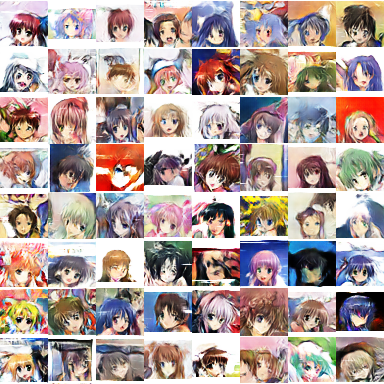

In [22]:
fake = generator_fn(fixed_noise)
showX(fake, 8)